# Import necessary libraries

In [2]:
import os  # To interact with the operating system
import cv2  # For computer vision tasks
import numpy as np  # For numerical operations
import pandas as pd  # For data manipulation and analysis
import nibabel as nib  # For working with neuroimaging data
from scipy import ndimage  # For image processing
import seaborn as sns  # For statistical data visualization
import matplotlib.pyplot as plt  # For creating visualizations
from skimage import transform, data, io  # For image processing tasks
import shutil  # For high-level file operations
import zipfile  # For working with zip files
import tensorflow as tf  # For building and training neural networks
from tensorflow import keras  # Keras API for TensorFlow
from keras.layers import Input, Conv3D, MaxPooling3D, Flatten, Dense, Dropout  # Components for building neural network layers
from keras.models import Model  # To define the architecture of a model
from keras.optimizers import Adadelta  # Optimization algorithm
from keras.utils import to_categorical  # Utility function for one-hot encoding
from sklearn.model_selection import train_test_split  # To split data into training and testing sets
from scipy.ndimage import rotate  # To rotate images
from skimage.transform import resize  # To resize images
from PIL import Image  # Python Imaging Library for image processing tasks
import keras.backend as K  # Keras backend operations
from keras.callbacks import CSVLogger, ModelCheckpoint, ReduceLROnPlateau, EarlyStopping, TensorBoard  # Feedback during training
from tensorflow.keras.layers.experimental import preprocessing  # For preprocessing layers in Keras


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Load Data

In [ ]:
import os
import shutil

# Path to the PMCI folder containing the images
pmci_folder = '/content/drive/MyDrive/PMCI_final'

# Path to the SMCCI folder containing the images
smci_folder = '/content/drive/MyDrive/SMCI_final'

# Destination folder path for "mask_R.nii.gz" images of PMCI
pmci_r_folder = '/content/drive/MyDrive/PMCI_R'

# Destination folder path for "mask_L.nii.gz" images of PMCI
pmci_l_folder = '/content/drive/MyDrive/PMCI_L'

# Destination folder path for "mask_R.nii.gz" images of SMCI
smci_r_folder = '/content/drive/MyDrive/SMCI_R'

# Destination folder path for "mask_L.nii.gz" images of SMCI
smci_l_folder = '/content/drive/MyDrive/SMCI_L'

# Create destination folders if they do not exist
os.makedirs(pmci_r_folder, exist_ok=True)
os.makedirs(pmci_l_folder, exist_ok=True)
os.makedirs(smci_r_folder, exist_ok=True)
os.makedirs(smci_l_folder, exist_ok=True)

# Iterate through the files in the PMCI folder and copy the "mask_R" and "mask_L" images to the appropriate folders
for filename in os.listdir(pmci_folder):
    if filename.endswith('mask_R.nii.gz'):
        source_file_path = os.path.join(pmci_folder, filename)
        destination_folder = pmci_r_folder
        shutil.copy(source_file_path, destination_folder)
    elif filename.endswith('mask_L.nii.gz'):
        source_file_path = os.path.join(pmci_folder, filename)
        destination_folder = pmci_l_folder
        shutil.copy(source_file_path, destination_folder)

# Iterate through the files in the SMCI folder and copy the "mask_R" and "mask_L" images to the appropriate folders
for filename in os.listdir(smci_folder):
    if filename.endswith('mask_R.nii.gz'):
        source_file_path = os.path.join(smci_folder, filename)
        destination_folder = smci_r_folder
        shutil.copy(source_file_path, destination_folder)
    elif filename.endswith('mask_L.nii.gz'):
        source_file_path = os.path.join(smci_folder, filename)
        destination_folder = smci_l_folder
        shutil.copy(source_file_path, destination_folder)


In [ ]:
import os
import shutil

# Chemin vers le dossier PMCI contenant les images et les sous-dossiers
pmci_folder = '/content/drive/MyDrive/PMCI_final'

# Chemin vers le dossier SMCCI contenant les images et les sous-dossiers
smci_folder = '/content/drive/MyDrive/SMCI_final'

# Dossiers de destination pour les images "mask_R.nii.gz" de PMCI
pmci_r_folder = '/content/drive/MyDrive/PMCI_R'

# Dossiers de destination pour les images "mask_L.nii.gz" de PMCI
pmci_l_folder = '/content/drive/MyDrive/PMCI_L'

# Dossiers de destination pour les images "mask_R.nii.gz" de SMCI
smci_r_folder = '/content/drive/MyDrive/SMCI_R'

# Dossiers de destination pour les images "mask_L.nii.gz" de SMCI
smci_l_folder = '/content/drive/MyDrive/SMCI_L'

# Créer les dossiers de destination s'ils n'existent pas
for folder in [pmci_r_folder, pmci_l_folder, smci_r_folder, smci_l_folder]:
    os.makedirs(folder, exist_ok=True)

# Fonction pour parcourir les sous-dossiers et copier les fichiers correspondants
def copy_files(source_folder, r_destination, l_destination):
    for root, dirs, files in os.walk(source_folder):
        for file in files:
            if file.endswith('mask_R.nii.gz'):
                shutil.copy(os.path.join(root, file), r_destination)
            elif file.endswith('mask_L.nii.gz'):
                shutil.copy(os.path.join(root, file), l_destination)

# Copier les fichiers correspondants de PMCI
copy_files(pmci_folder, pmci_r_folder, pmci_l_folder)

# Copier les fichiers correspondants de SMCI
copy_files(smci_folder, smci_r_folder, smci_l_folder)


In [7]:
print(len(os.listdir('/content/drive/MyDrive/PMCI_L')))
print(len(os.listdir('/content/drive/MyDrive/PMCI_R')))
print(len(os.listdir('/content/drive/MyDrive/SMCI_L')))
print(len(os.listdir('/content/drive/MyDrive/SMCI_L')))


157
157
149
149


#Image Cropping and Visualization.

Image shape: (256, 256, 180)


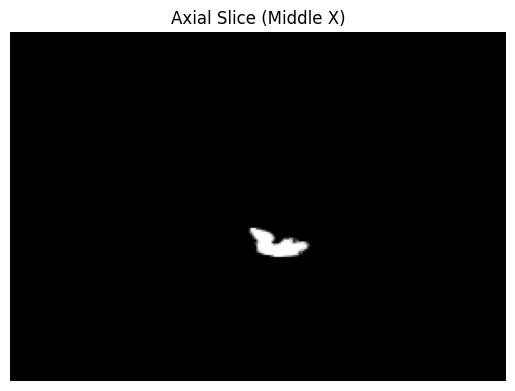

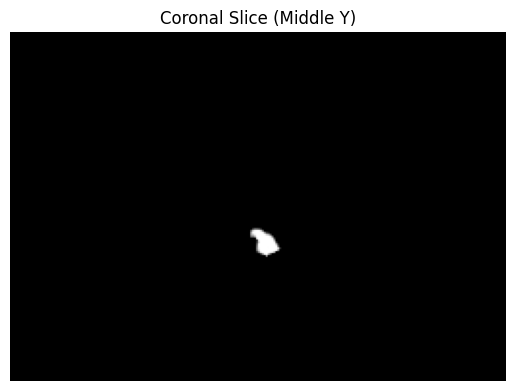

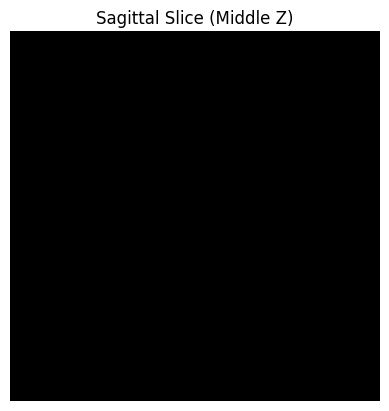

In [8]:
import nibabel as nib
import matplotlib.pyplot as plt

# Load an image using OpenCV
image_path = '/content/drive/MyDrive/SMCI_R/ADNI_009_S_1030_MR_MPR__GradWarp__N3__Scaled_Br_20071127112217373_S42811_I83352_mask_R.nii.gz_brain_mask_R.nii.gz_brain_mask_R.nii.gz'  # Replace with your image path


# Load a 3D NIFTI file
image = nib.load(image_path)

# Get the data from the NIFTI file
data = image.get_fdata()
print('Image shape:', data.shape)  # This prints the shape (e.g., X, Y, Z dimensions of the MRI)

# Function to plot a slice
def plot_slice(slice_data, title):
    plt.figure()
    plt.imshow(slice_data.T, cmap="gray", origin="lower")
    plt.title(title)
    plt.axis('off')  # Turn off axis numbers and ticks

# Display slices from the image: one axial, one coronal, and one sagittal
plot_slice(data[data.shape[0] // 2, :, :], 'Axial Slice (Middle X)')
plot_slice(data[:, data.shape[1] // 2, :], 'Coronal Slice (Middle Y)')
plot_slice(data[:, :, data.shape[2] // 2], 'Sagittal Slice (Middle Z)')

plt.show()


In [5]:

# Path to the PMCI folder containing the images
pmci_folder = '/content/drive/MyDrive/PMCI_final'

# Path to the SMCCI folder containing the images
smci_folder = '/content/drive/MyDrive/SMCI_final'

# Destination folder path for "mask_R.nii.gz" images of PMCI
pmci_r_folder = '/content/drive/MyDrive/PMCI_R'

# Destination folder path for "mask_L.nii.gz" images of PMCI
pmci_l_folder = '/content/drive/MyDrive/PMCI_L'

# Destination folder path for "mask_R.nii.gz" images of SMCI
smci_r_folder = '/content/drive/MyDrive/SMCI_R'

# Destination folder path for "mask_L.nii.gz" images of SMCI
smci_l_folder = '/content/drive/MyDrive/SMCI_L'

In [6]:
# get the list of all PMCI files in the folder
pmciR_files = [os.path.join(pmci_r_folder, file) for file in os.listdir(pmci_r_folder)]
pmciL_files = [os.path.join(pmci_l_folder, file) for file in os.listdir(pmci_l_folder)]


Crop Function

In [7]:
# crop NIfTI images
def load_data(file_paths, patch_shape=(72, 64, 64)):
    data = []
    for path in file_paths:
        img = nib.load(path)
        arr = img.get_fdata()
        center_x = arr.shape[0] // 2
        center_y = arr.shape[1] // 2
        center_z = arr.shape[2] // 2
        crop_x = patch_shape[0] // 2
        crop_y = patch_shape[1] // 2
        crop_z = patch_shape[2] // 2
        cropped_arr = arr[center_x - crop_x: center_x + crop_x,
                          center_y - crop_y: center_y + crop_y,
                          center_z - crop_z: center_z + crop_z]
        data.append(cropped_arr)
    return np.array(data)

In [9]:
# load PMCI data
pmciR_data = load_data(pmciR_files[:100])
pmciL_data = load_data(pmciL_files[:100])

print("Dimensions de pmciR_data :", pmciR_data.shape)
print("Dimensions de pmciL_data :", pmciL_data.shape)

Dimensions de pmciR_data : (100, 72, 64, 64)
Dimensions de pmciL_data : (100, 72, 64, 64)


In [10]:
# get the list of all SMCI files in the folder
smciR_files = [os.path.join(smci_r_folder, file) for file in os.listdir(smci_r_folder)]
smciL_files = [os.path.join(smci_l_folder, file) for file in os.listdir(smci_l_folder)]

In [11]:
# Load SMCI data
smciR_data = load_data(smciR_files[:100])
smciL_data = load_data(smciL_files[:100])

print("Dimensions de smciR_data :", smciR_data.shape)
print("Dimensions de smciL_data :", smciL_data.shape)

Dimensions de smciR_data : (100, 72, 64, 64)
Dimensions de smciL_data : (100, 72, 64, 64)


plot of images from the data

In [ ]:
def plot_slices(data, title):
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 5))

    # Display axial slice
    ax = axes[0]
    ax.imshow(data[data.shape[0] // 2], cmap='gray')
    ax.set_title('Axial')

    # Display sagittal slice
    ax = axes[1]
    ax.imshow(data[:, data.shape[1] // 2, :], cmap='gray')
    ax.set_title('Sagittal')

    # Display coronal slice
    ax = axes[2]
    ax.imshow(data[:, :, data.shape[2] // 2], cmap='gray')
    ax.set_title('Coronal')

    plt.suptitle(title)
    plt.show()


SMCI Left

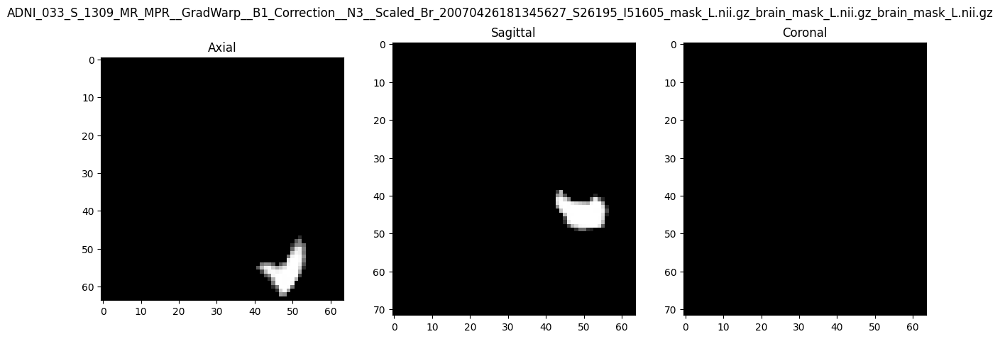

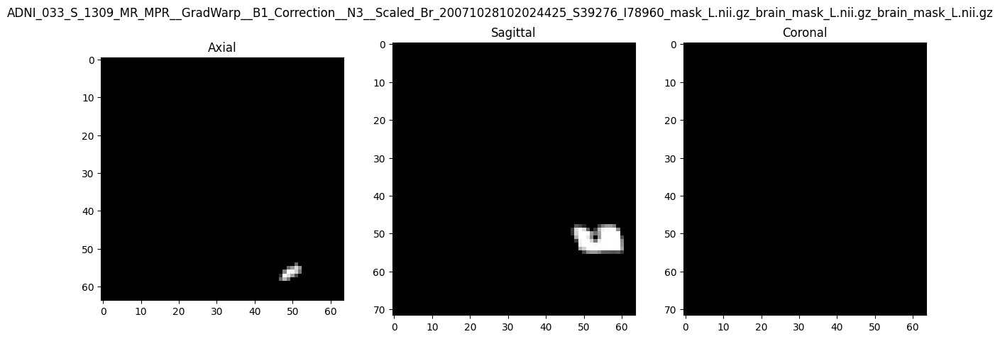

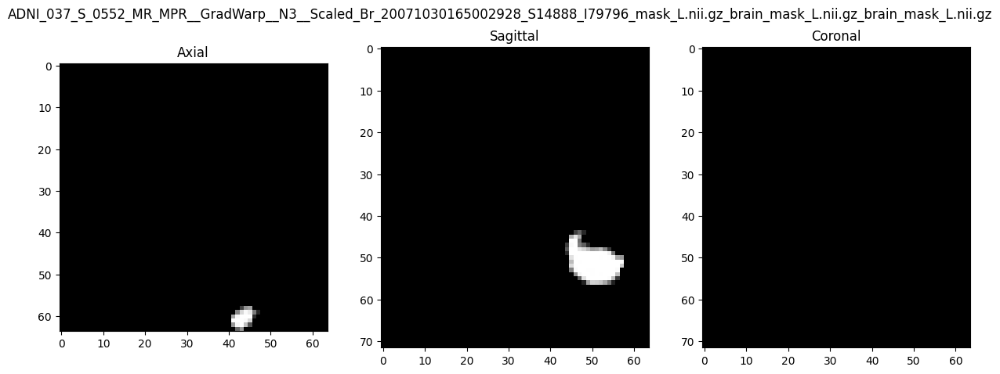

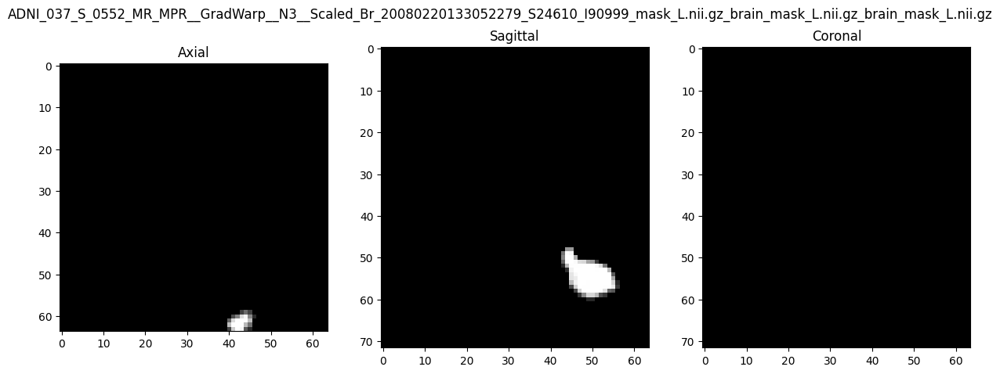

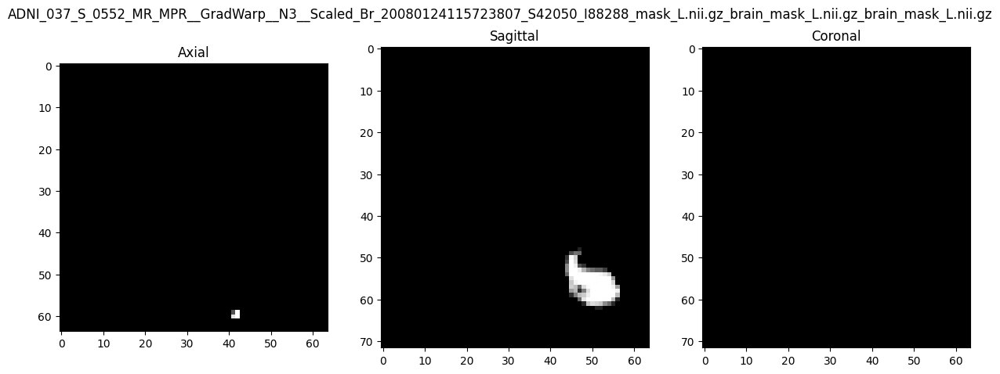

...

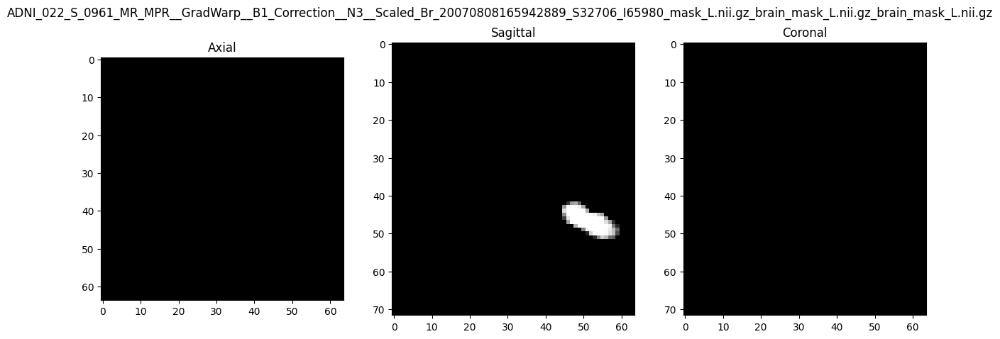

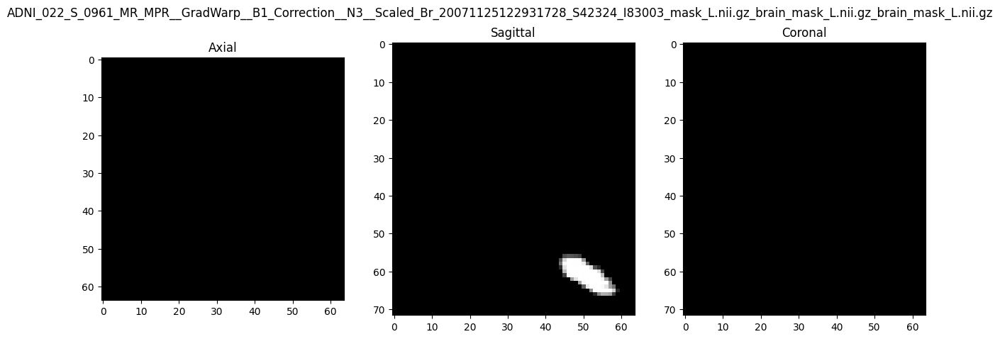

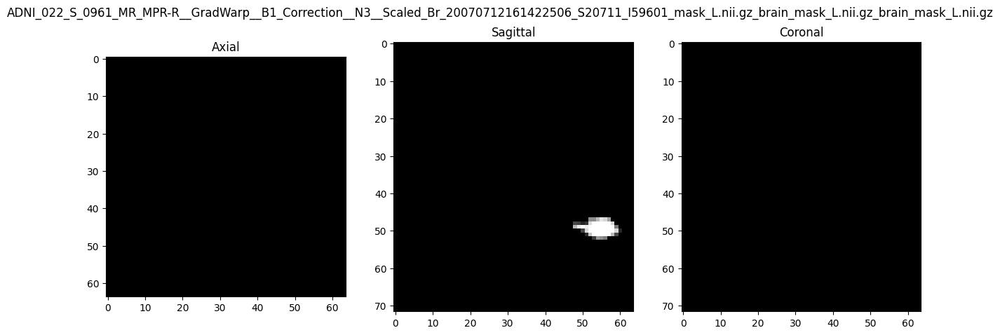

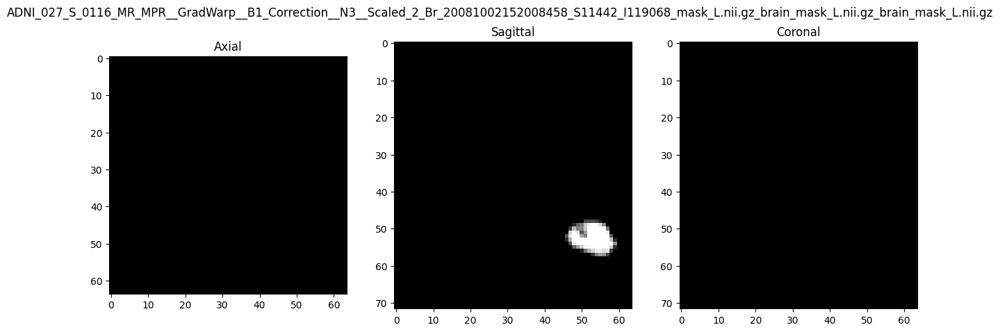

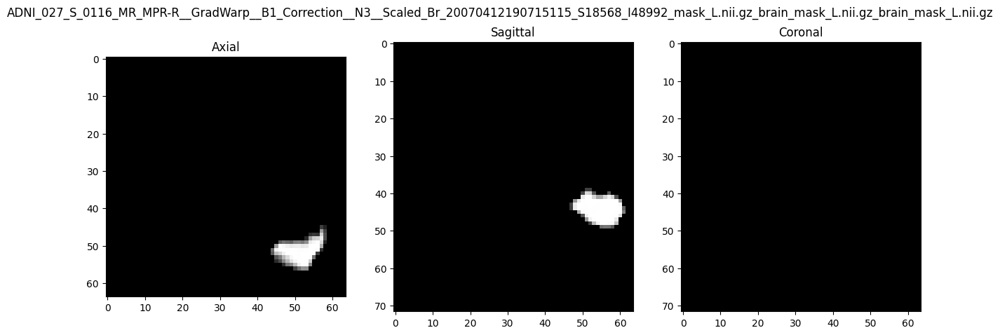

In [ ]:
import os

# Path to the folder containing SMCI-L images
smci_mask_l_folder = '/content/drive/MyDrive/SMCI_L'

# Get the list of all SMCI-L files in the folder
smciL_files = [os.path.join(smci_l_folder, file) for file in os.listdir(smci_l_folder)]

# Load SMCI-L data
smciL_data = load_data(smciL_files[:100])

# Function to extract the filename from the filepath
def extract_filename(filepath):
    return os.path.basename(filepath)

# Display SMCI-L images with their filename
for filepath, data in zip(smciL_files[:smciL_data.shape[0]], smciL_data):
    filename = extract_filename(filepath)
    plot_slices(data, filename)



SMCI Right

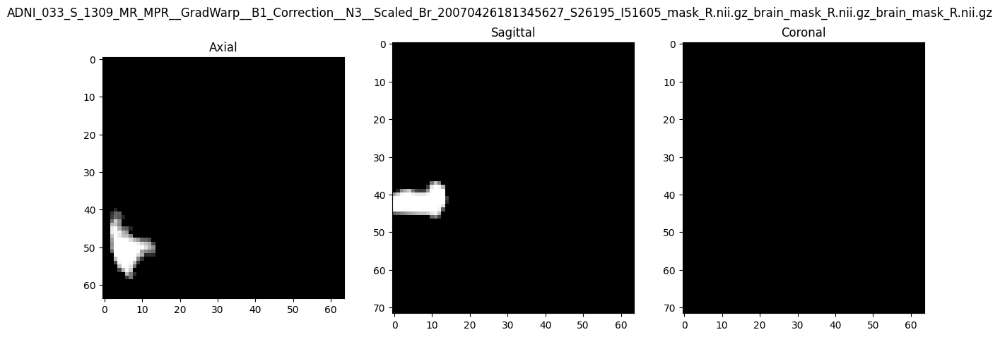

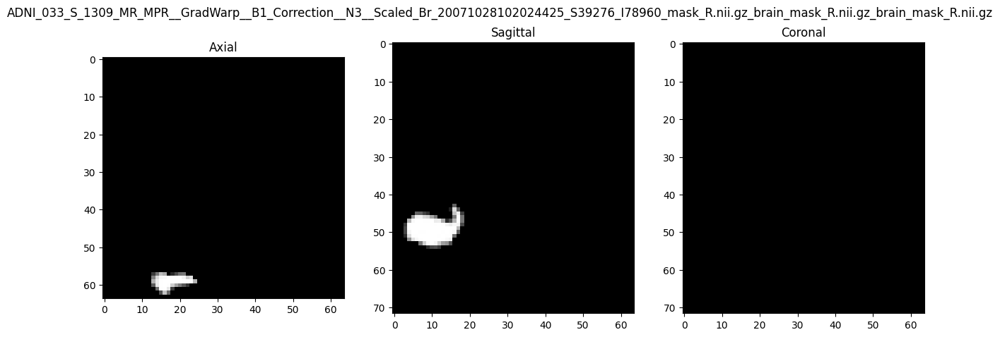

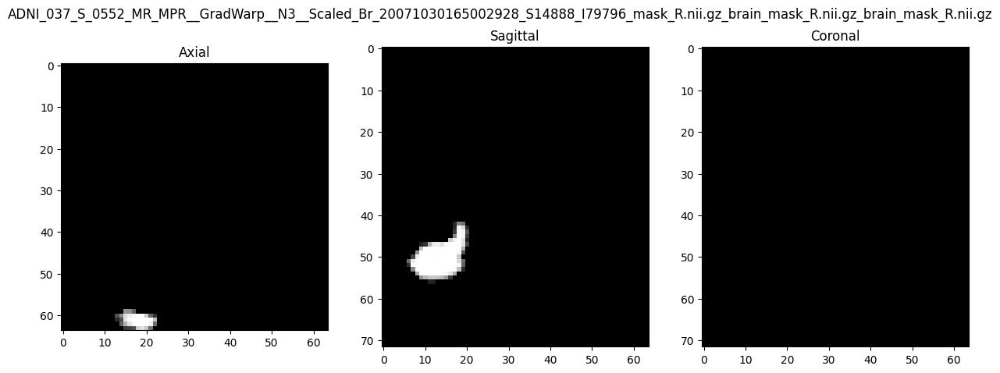

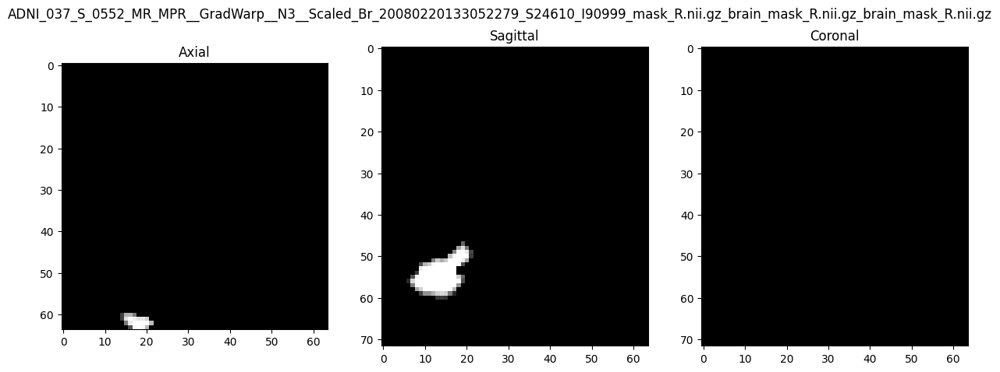

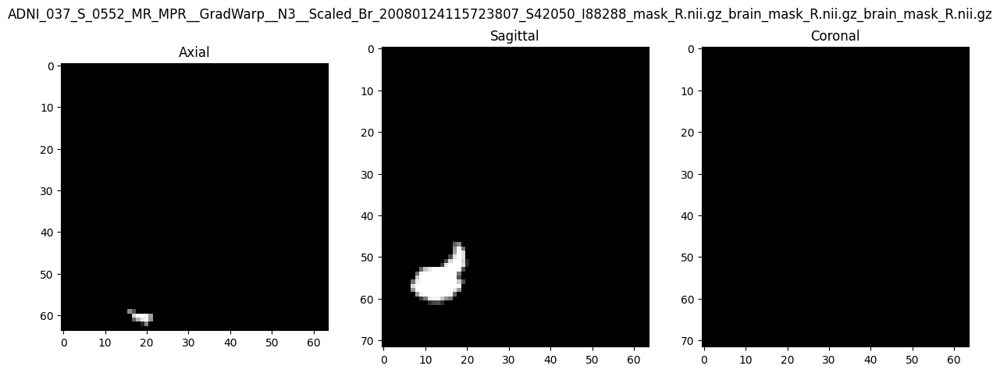

...

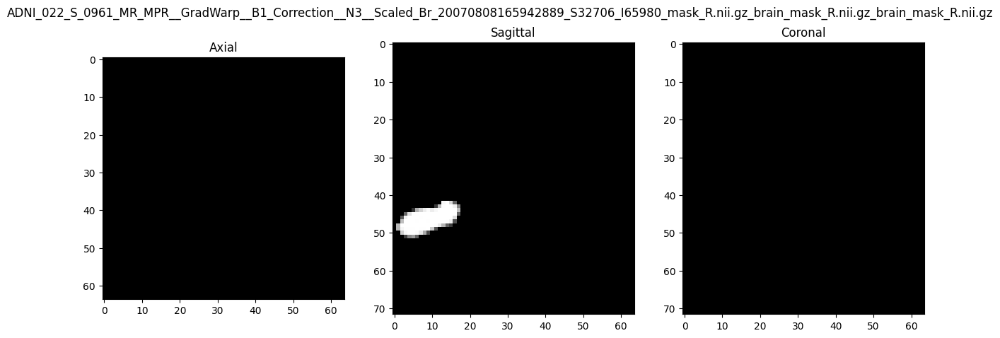

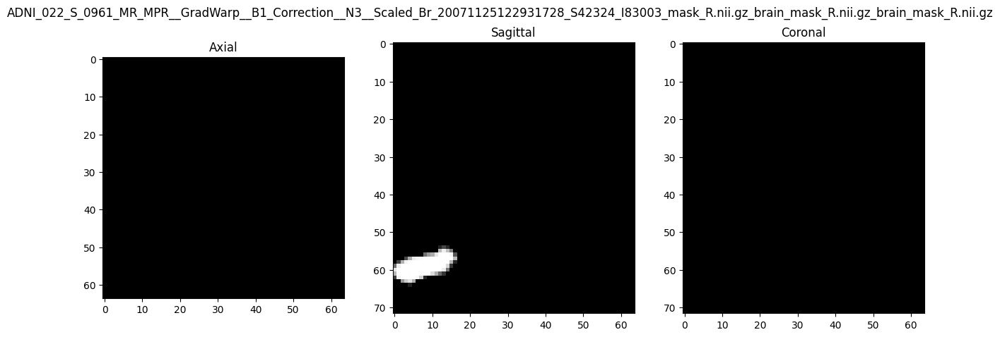

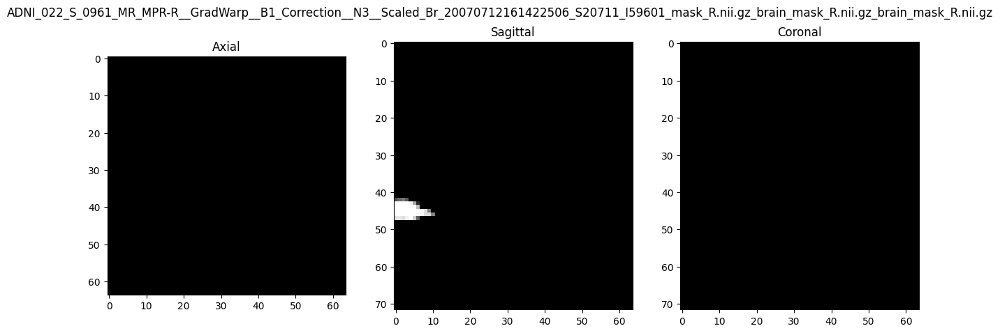

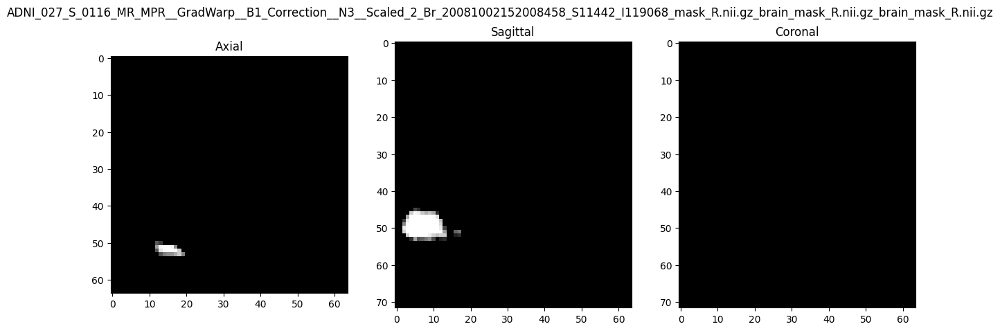

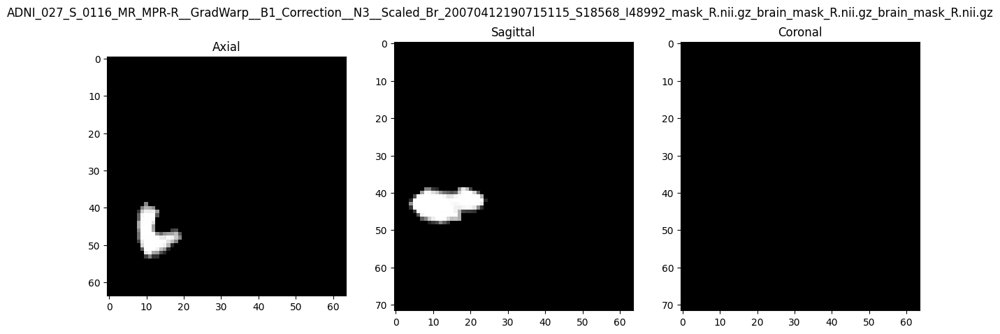

In [ ]:
import os

# Path to the folder containing SMCI-R images
smci_mask_r_folder = '/content/drive/MyDrive/SMCI_R'

# Get the list of all SMCI-R files in the folder
smciR_files = [os.path.join(smci_r_folder, file) for file in os.listdir(smci_r_folder)]

# Load SMCI-R data
smciR_data = load_data(smciR_files[:100])

# Function to extract the filename from the filepath
def extract_filename(filepath):
    return os.path.basename(filepath)

# Display SMCI-R images with their filename
for filepath, data in zip(smciR_files[:smciR_data.shape[0]], smciR_data):
    filename = extract_filename(filepath)
    plot_slices(data, filename)


PMCI Right

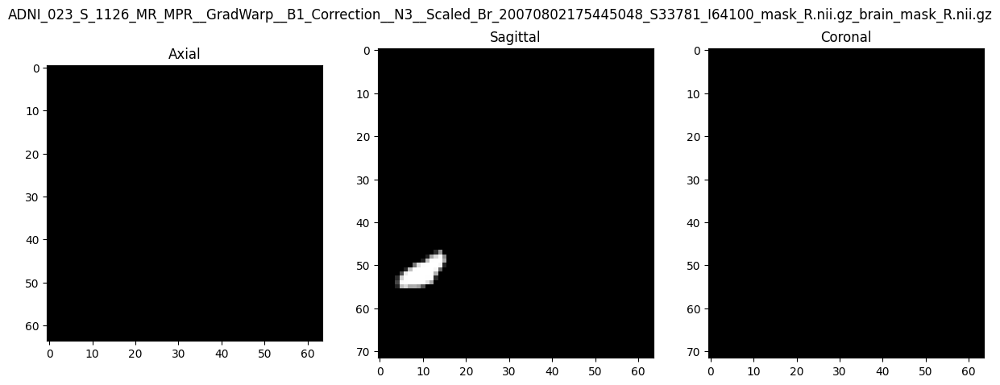

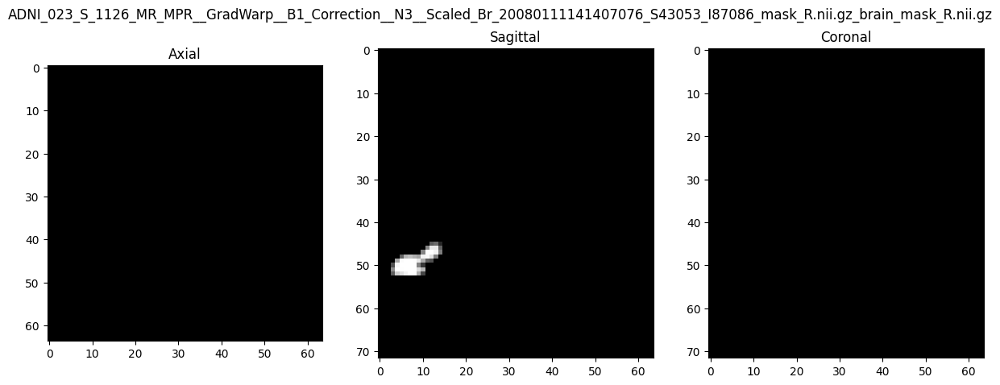

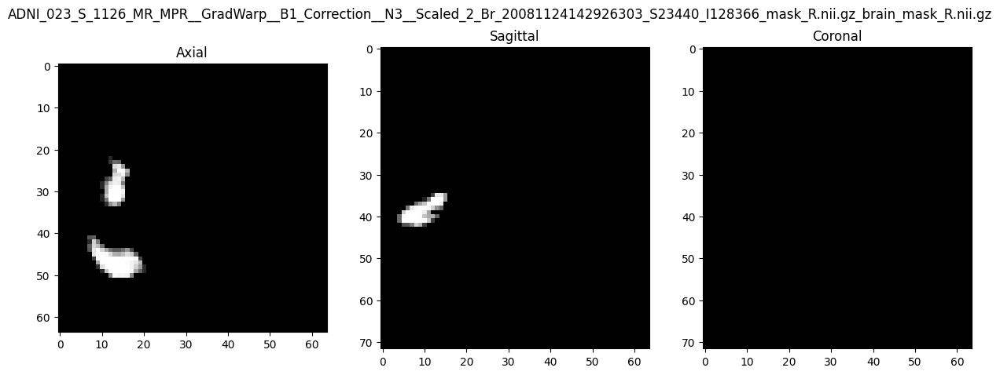

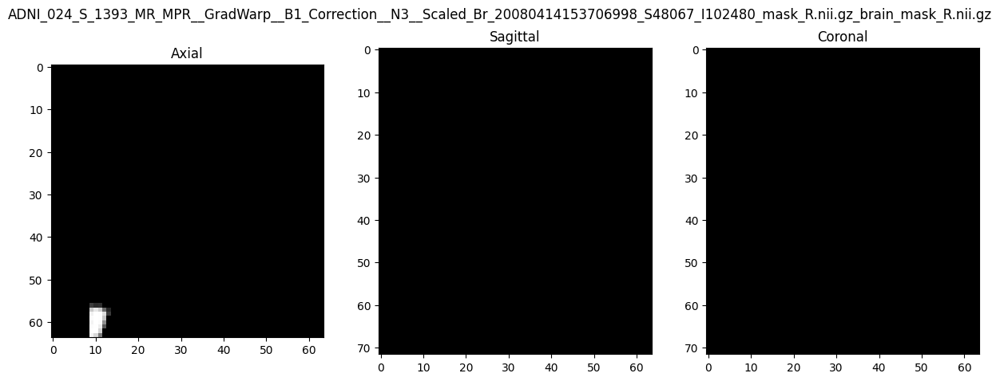

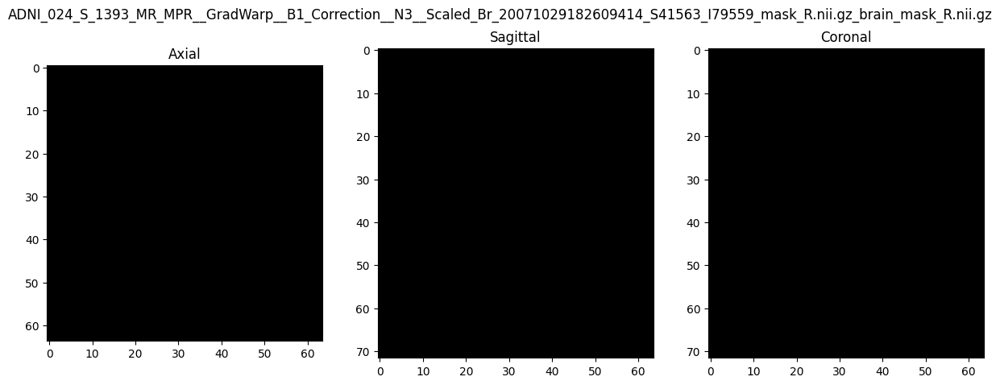

...

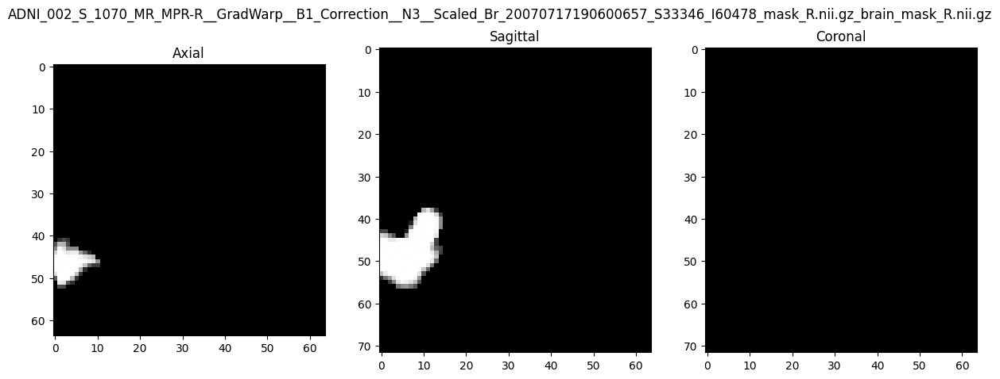

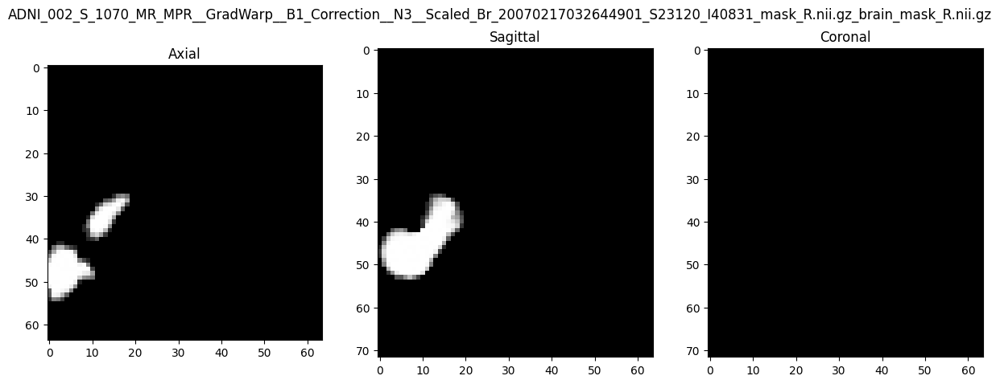

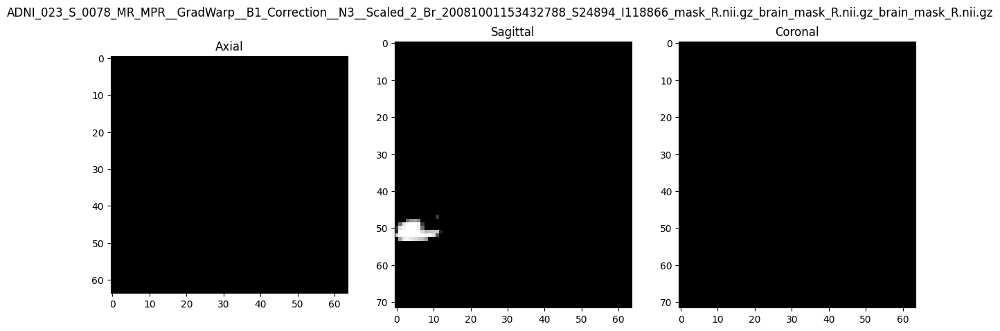

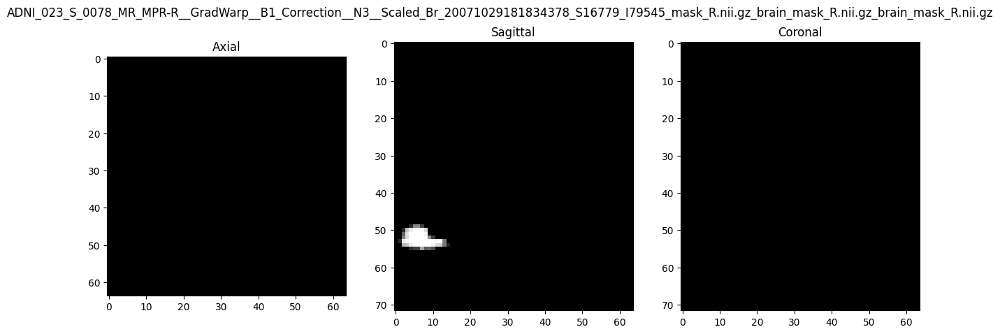

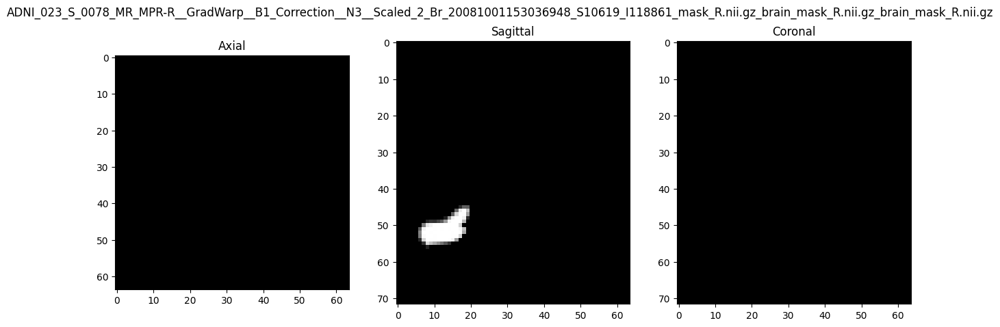

In [ ]:
import os

# Path to the folder containing PMCI-R images
pmci_mask_r_folder = '/content/drive/MyDrive/PMCI_R'

# Get the list of all PMCI-R files in the folder
pmciR_files = [os.path.join(pmci_r_folder, file) for file in os.listdir(pmci_r_folder)]

# Load PMCI-R data
pmciR_data = load_data(pmciR_files[:100])

# Function to extract the filename from the filepath
def extract_filename(filepath):
    return os.path.basename(filepath)

# Display PMCI-R images with their filename
for filepath, data in zip(pmciR_files[:pmciR_data.shape[0]], pmciR_data):
    filename = extract_filename(filepath)
    plot_slices(data, filename)


PMCI Left

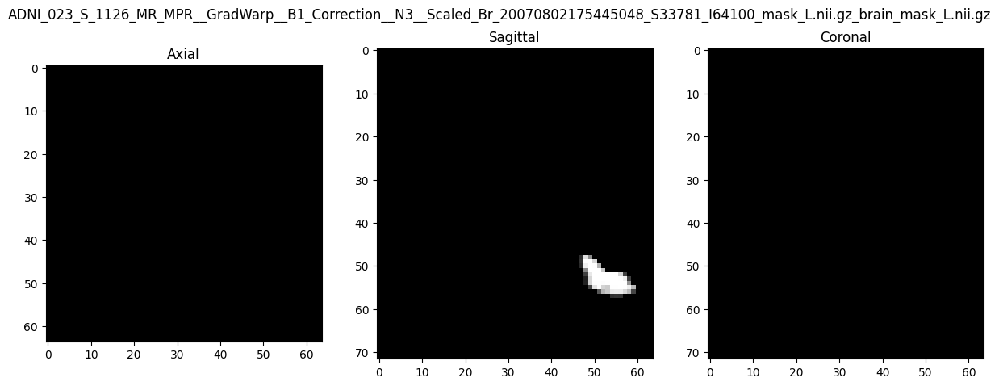

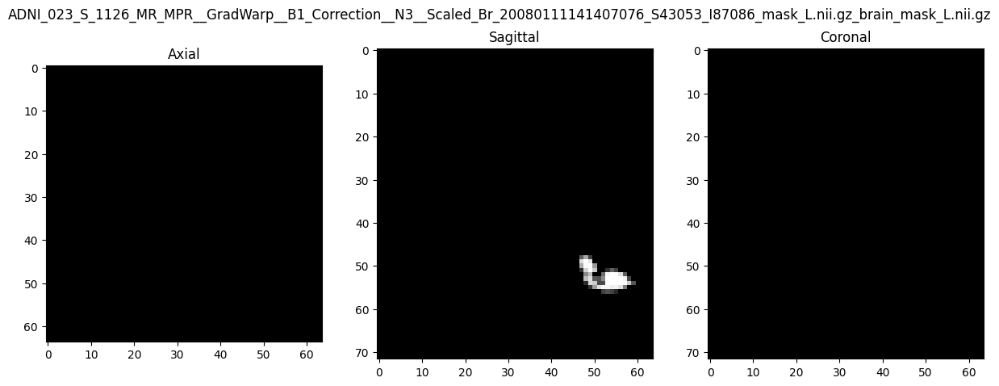

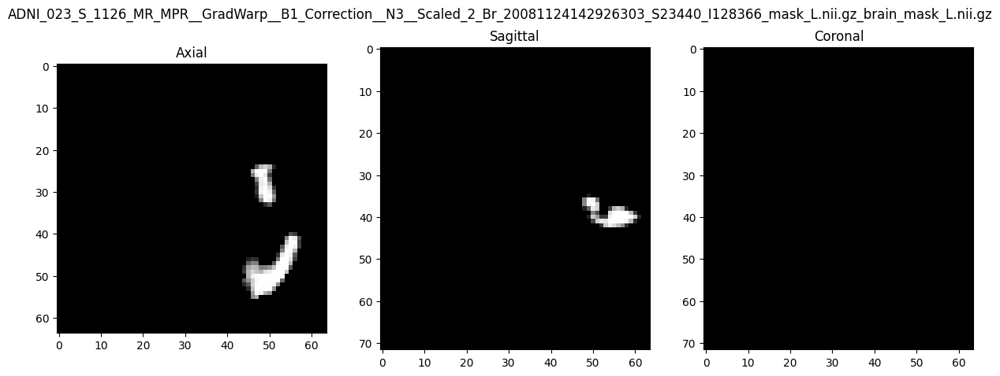

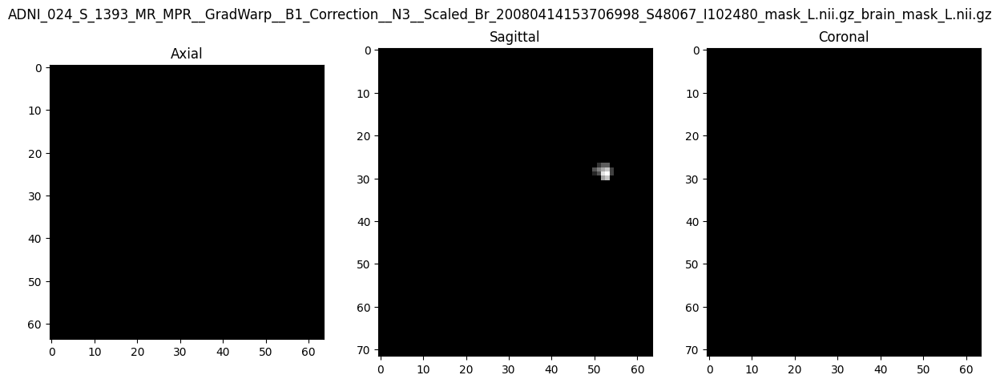

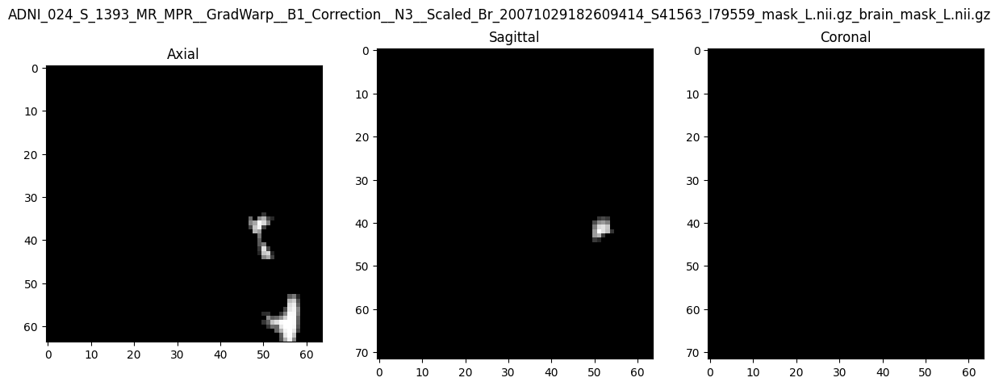

...

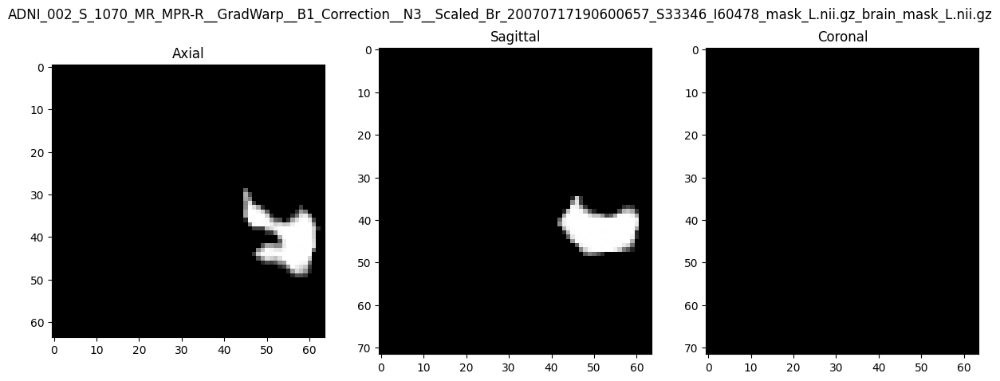

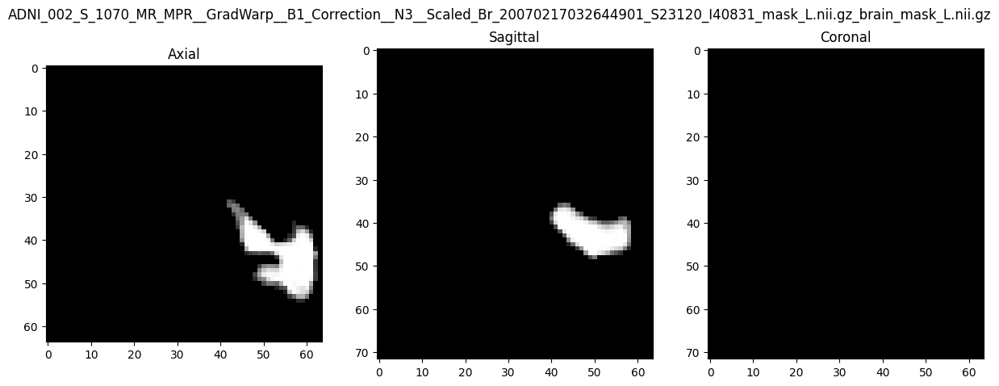

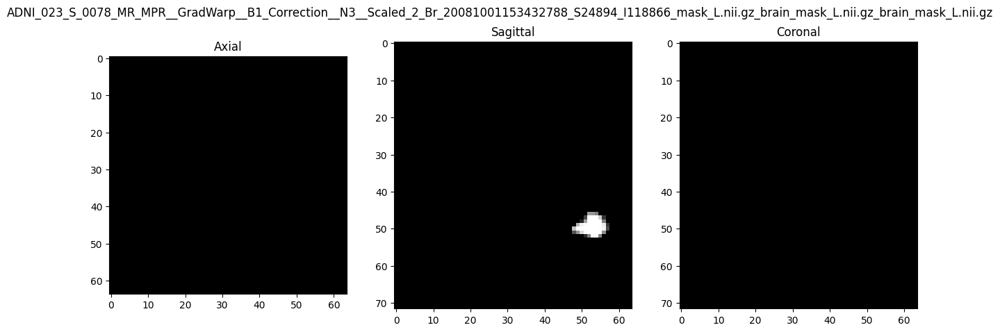

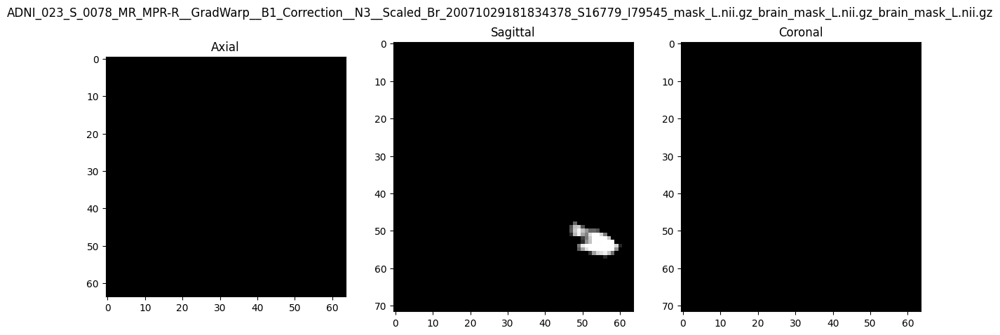

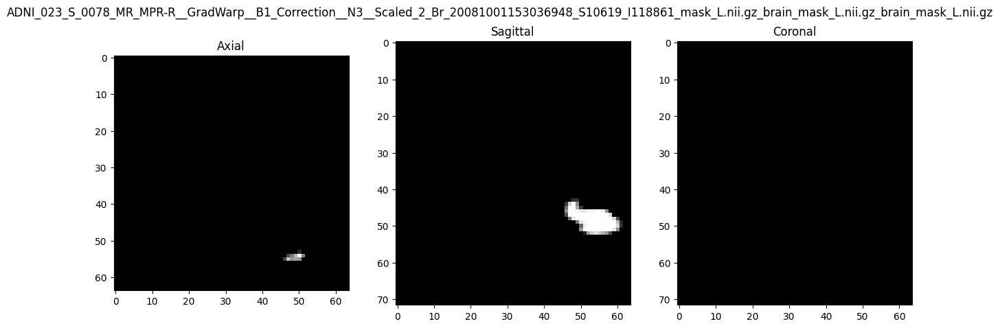

In [ ]:
import os

# Path to the folder containing PMCI-L images
pmci_mask_l_folder = '/content/drive/MyDrive/PMCI_L'

# Get the list of all PMCI-L files in the folder
pmciL_files = [os.path.join(pmci_l_folder, file) for file in os.listdir(pmci_l_folder)]

# Load PMCI-L data
pmciL_data = load_data(pmciL_files[:100])

# Function to extract the filename from the filepath
def extract_filename(filepath):
    return os.path.basename(filepath)

# Display PMCI-L images with their filename
for filepath, data in zip(pmciL_files[:pmciL_data.shape[0]], pmciL_data):
    filename = extract_filename(filepath)
    plot_slices(data, filename)


#splitting training and testing dataset

In [12]:

print("Dimensions de pmciR_data :", pmciR_data.shape)
print("Dimensions de pmciL_data :", pmciL_data.shape)

print("Dimensions de smciR_data :", smciR_data.shape)
print("Dimensions de smciL_data :", smciL_data.shape)

Dimensions de pmciR_data : (100, 72, 64, 64)
Dimensions de pmciL_data : (100, 72, 64, 64)
Dimensions de smciR_data : (100, 72, 64, 64)
Dimensions de smciL_data : (100, 72, 64, 64)


In [13]:
# Concatenate the data and label the classes "right"
X = np.concatenate((pmciR_data, smciR_data), axis=0)
y = np.concatenate((np.zeros(pmciR_data.shape[0]), np.ones(smciR_data.shape[0])), axis=0)


In [66]:
y

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])

In [14]:
# Split the data into training and testing sets for "right"
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [15]:
X_train_resized=X_train.reshape(X_train.shape[0],72,64,64,1)
X_test_resized=  X_test.reshape(X_test.shape[0],72,64,64,1)

In [20]:
X_train_resized.shape


(160, 72, 64, 64, 1)

In [21]:
X_test_resized.shape

(40, 72, 64, 64, 1)

In [16]:
# Reshape labels
yb_train = y_train.reshape((-1, 1))
yb_test = y_test.reshape((-1, 1))

In [17]:
# Concatenate the data and label the classes "left"
X1 = np.concatenate((pmciL_data, smciL_data), axis=0)
y1 = np.concatenate((np.zeros(pmciL_data.shape[0]), np.ones(smciL_data.shape[0])), axis=0)


In [18]:

# Split the data into training and testing sets for "left"
X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size=0.2, random_state=0)

In [19]:
X1_train_resized=X1_train.reshape(X1_train.shape[0],72,64,64,1)
X1_test_resized=  X1_test.reshape(X1_test.shape[0],72,64,64,1)

In [26]:
X1_train_resized.shape


(160, 72, 64, 64, 1)

In [27]:
X1_test_resized.shape

(40, 72, 64, 64, 1)

In [20]:
# Reshape labels
yb1_train = y1_train.reshape((-1, 1))
yb1_test = y1_test.reshape((-1, 1))

# Build Model, Optimizer and Loss Function


In [21]:
from tensorflow.keras import Model, Input, regularizers
from tensorflow.keras.layers import Conv3D, MaxPooling3D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam

def create_model(input_shape=(72, 64, 64, 1), weight_decay=1e-5, learning_rate=1e-3):

  # Define the input layer
  inputs = Input(shape=input_shape)

  # Convolutional layers with tanh activation and max pooling
  x = Conv3D(16, kernel_size=(3, 3, 3), activation='relu', kernel_regularizer=regularizers.l2(weight_decay))(inputs)
  x = BatchNormalization()(x)
  x = MaxPooling3D(pool_size=(2, 2, 2))(x)

  x = Conv3D(32, kernel_size=(3, 3, 3), activation='relu', kernel_regularizer=regularizers.l2(weight_decay))(x)
  x = BatchNormalization()(x)
  x = MaxPooling3D(pool_size=(2, 2, 2))(x)

  x = Conv3D(64, kernel_size=(3, 3, 3), activation='relu', kernel_regularizer=regularizers.l2(weight_decay))(x)
  x = BatchNormalization()(x)
  x = MaxPooling3D(pool_size=(2, 2, 2))(x)

  x = Conv3D(128, kernel_size=(1, 1, 1), activation='relu', kernel_regularizer=regularizers.l2(weight_decay))(x)
  x = BatchNormalization()(x)

  x = MaxPooling3D(pool_size=(2, 2, 2))(x)

  x = Conv3D(512, kernel_size=(3, 3, 3), activation='relu', padding='same', kernel_regularizer=regularizers.l2(weight_decay))(x)
  x = BatchNormalization()(x)
  x = MaxPooling3D(pool_size=(2, 2, 2))(x)

  # Flatten the 3D output to 1D
  x = Flatten()(x)

  # Dense layers with relu activation
  x = Dense(512, activation='relu', kernel_regularizer=regularizers.l2(weight_decay))(x)
  x = Dense(256, activation='relu', kernel_regularizer=regularizers.l2(weight_decay))(x)
  x = Dense(64, activation='relu', kernel_regularizer=regularizers.l2(weight_decay))(x)

  # Output layer with sigmoid activation for binary classification
  outputs = Dense(1, activation='sigmoid')(x)

  # Create the functional model
  model = Model(inputs=inputs, outputs=outputs)

  # Define optimizer with specified learning rate
  optimizer = Adam(learning_rate=learning_rate)

  # Compile the model with the optimizer and loss function
  model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

  return model


In [22]:

# Création du modèle
model = create_model()

# Résumé du modèle
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 72, 64, 64, 1)]   0         
                                                                 
 conv3d (Conv3D)             (None, 70, 62, 62, 16)    448       
                                                                 
 batch_normalization (Batch  (None, 70, 62, 62, 16)    64        
 Normalization)                                                  
                                                                 
 max_pooling3d (MaxPooling3  (None, 35, 31, 31, 16)    0         
 D)                                                              
                                                                 
 conv3d_1 (Conv3D)           (None, 33, 29, 29, 32)    13856     
                                                                 
 batch_normalization_1 (Bat  (None, 33, 29, 29, 32)    128   

Right data

In [34]:
# train the model
model.fit(X_train_resized, yb_train, batch_size=16, epochs=25, validation_split=0.15)

Epoch 1/25
9/9 [==============================] - 117s 13s/step - loss: 1.0261 - accuracy: 0.5368 - val_loss: 1.2130 - val_accuracy: 0.5833
Epoch 2/25
9/9 [==============================] - 117s 13s/step - loss: 0.6812 - accuracy: 0.5956 - val_loss: 0.9645 - val_accuracy: 0.6667
Epoch 3/25
9/9 [==============================] - 117s 13s/step - loss: 0.5371 - accuracy: 0.7426 - val_loss: 2.0015 - val_accuracy: 0.5833
Epoch 4/25
9/9 [==============================] - 111s 12s/step - loss: 0.5336 - accuracy: 0.7574 - val_loss: 0.7561 - val_accuracy: 0.6250
Epoch 5/25
9/9 [==============================] - 114s 13s/step - loss: 0.4911 - accuracy: 0.7647 - val_loss: 0.6362 - val_accuracy: 0.6667
Epoch 6/25
9/9 [==============================] - 108s 12s/step - loss: 0.3119 - accuracy: 0.8750 - val_loss: 0.7691 - val_accuracy: 0.5833
Epoch 7/25
9/9 [==============================] - 114s 13s/step - loss: 0.2448 - accuracy: 0.9118 - val_loss: 0.7452 - val_accuracy: 0.5833
Epoch 8/25
9/9 [====

In [35]:
score = model.evaluate(X_test_resized, yb_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

Test loss: 1.7561843395233154
Test accuracy: 0.5249999761581421


plot of results (right images)

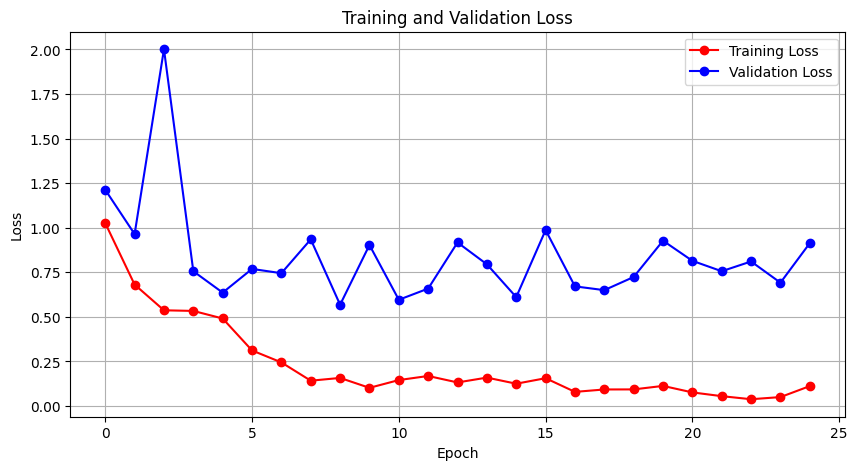

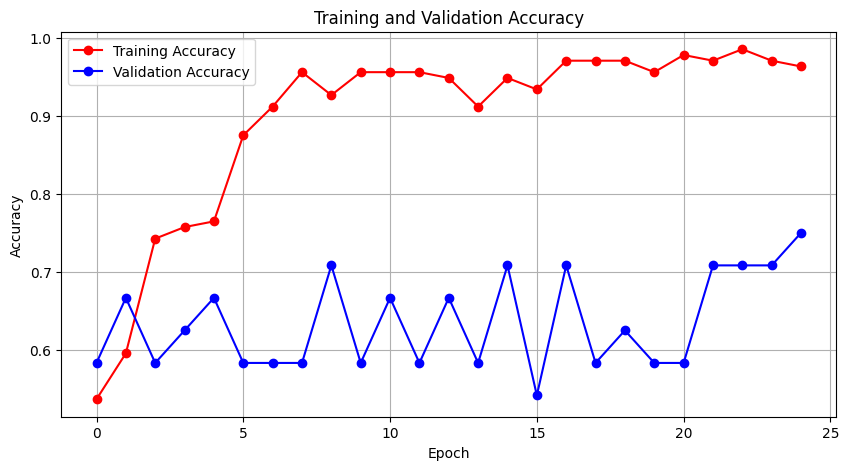

In [42]:
import matplotlib.pyplot as plt

# Define the training history
history = {
    "loss": [1.0261, 0.6812, 0.5371, 0.5336, 0.4911, 0.3119, 0.2448, 0.1422, 0.1577, 0.1022,
             0.1457, 0.1687, 0.1324, 0.1596, 0.1253, 0.1562, 0.0795, 0.0930, 0.0934, 0.1130,
             0.0765, 0.0555, 0.0383, 0.0503, 0.1119],
    "accuracy": [0.5368, 0.5956, 0.7426, 0.7574, 0.7647, 0.8750, 0.9118, 0.9559, 0.9265, 0.9559,
                 0.9559, 0.9559, 0.9485, 0.9118, 0.9485, 0.9338, 0.9706, 0.9706, 0.9706, 0.9559,
                 0.9779, 0.9706, 0.9853, 0.9706, 0.9632],
    "val_loss": [1.2130, 0.9645, 2.0015, 0.7561, 0.6362, 0.7691, 0.7452, 0.9348, 0.5683, 0.9033,
                 0.5961, 0.6589, 0.9176, 0.7951, 0.6110, 0.9869, 0.6713, 0.6501, 0.7239, 0.9275,
                 0.8146, 0.7562, 0.8110, 0.6919, 0.9138],
    "val_accuracy": [0.5833, 0.6667, 0.5833, 0.6250, 0.6667, 0.5833, 0.5833, 0.5833, 0.7083, 0.5833,
                     0.6667, 0.5833, 0.6667, 0.5833, 0.7083, 0.5417, 0.7083, 0.5833, 0.6250, 0.5833,
                     0.5833, 0.7083, 0.7083, 0.7083, 0.7500]
}

# Plot training and validation loss
plt.figure(figsize=(10, 5))
plt.plot(history['loss'], label='Training Loss', color='red', marker='o')
plt.plot(history['val_loss'], label='Validation Loss', color='blue', marker='o')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()

# Plot training and validation accuracy
plt.figure(figsize=(10, 5))
plt.plot(history['accuracy'], label='Training Accuracy', color='red', marker='o')
plt.plot(history['val_accuracy'], label='Validation Accuracy', color='blue', marker='o')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()



Left Data

In [38]:
# train the model
model.fit(X1_train_resized, yb1_train, batch_size=16, epochs=25, validation_split=0.15)

Epoch 1/25
9/9 [==============================] - 113s 13s/step - loss: 1.0032 - accuracy: 0.5368 - val_loss: 0.6704 - val_accuracy: 0.6250
Epoch 2/25
9/9 [==============================] - 113s 13s/step - loss: 0.6846 - accuracy: 0.5956 - val_loss: 0.5501 - val_accuracy: 0.6667
Epoch 3/25
9/9 [==============================] - 114s 13s/step - loss: 0.6199 - accuracy: 0.6985 - val_loss: 0.6889 - val_accuracy: 0.6250
Epoch 4/25
9/9 [==============================] - 112s 12s/step - loss: 0.5669 - accuracy: 0.6985 - val_loss: 0.6295 - val_accuracy: 0.6667
Epoch 5/25
9/9 [==============================] - 112s 12s/step - loss: 0.4453 - accuracy: 0.8015 - val_loss: 0.5318 - val_accuracy: 0.7500
Epoch 6/25
9/9 [==============================] - 107s 12s/step - loss: 0.2492 - accuracy: 0.9191 - val_loss: 0.5292 - val_accuracy: 0.7500
Epoch 7/25
9/9 [==============================] - 110s 12s/step - loss: 0.1347 - accuracy: 0.9632 - val_loss: 0.5498 - val_accuracy: 0.6667
Epoch 8/25
9/9 [====

In [40]:
# Evaluate the model
score = model.evaluate(X1_test_resized, yb1_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

Test loss: 1.3276042938232422
Test accuracy: 0.6499999761581421


plot of results(left images)

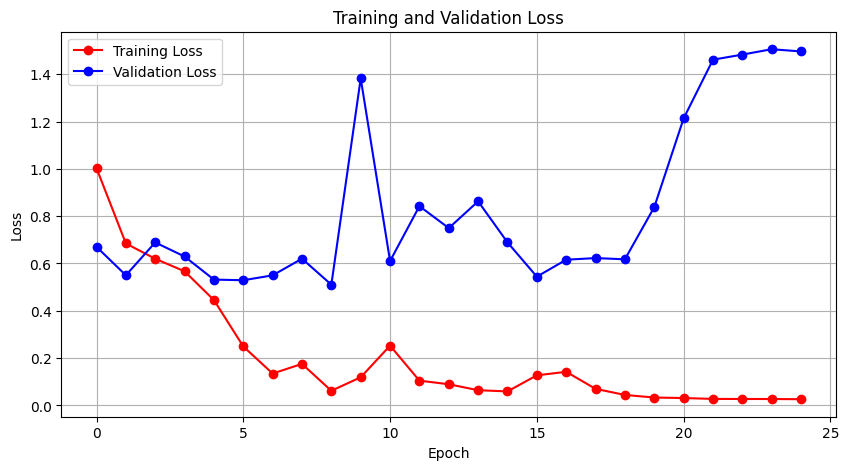

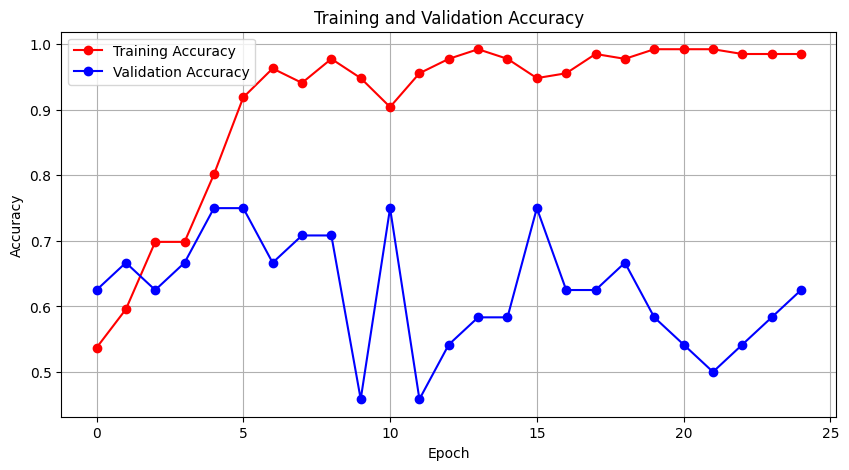

In [41]:
import matplotlib.pyplot as plt

# Define the training history
history = {
    "loss": [1.0032, 0.6846, 0.6199, 0.5669, 0.4453, 0.2492, 0.1347, 0.1754, 0.0618, 0.1188,
             0.2526, 0.1046, 0.0894, 0.0642, 0.0591, 0.1271, 0.1420, 0.0700, 0.0442, 0.0333,
             0.0311, 0.0274, 0.0271, 0.0270, 0.0261],
    "accuracy": [0.5368, 0.5956, 0.6985, 0.6985, 0.8015, 0.9191, 0.9632, 0.9412, 0.9779, 0.9485,
                 0.9044, 0.9559, 0.9779, 0.9926, 0.9779, 0.9485, 0.9559, 0.9853, 0.9779, 0.9926,
                 0.9926, 0.9926, 0.9853, 0.9853, 0.9853],
    "val_loss": [0.6704, 0.5501, 0.6889, 0.6295, 0.5318, 0.5292, 0.5498, 0.6202, 0.5104, 1.3825,
                 0.6103, 0.8424, 0.7496, 0.8627, 0.6892, 0.5442, 0.6159, 0.6228, 0.6177, 0.8382,
                 1.2131, 1.4615, 1.4831, 1.5058, 1.4964],
    "val_accuracy": [0.6250, 0.6667, 0.6250, 0.6667, 0.7500, 0.7500, 0.6667, 0.7083, 0.7083, 0.4583,
                     0.7500, 0.4583, 0.5417, 0.5833, 0.5833, 0.7500, 0.6250, 0.6250, 0.6667, 0.5833,
                     0.5417, 0.5000, 0.5417, 0.5833, 0.6250]
}

# Plot training and validation loss
plt.figure(figsize=(10, 5))
plt.plot(history['loss'], label='Training Loss', color='red', marker='o')
plt.plot(history['val_loss'], label='Validation Loss', color='blue', marker='o')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()

# Plot training and validation accuracy
plt.figure(figsize=(10, 5))
plt.plot(history['accuracy'], label='Training Accuracy', color='red', marker='o')
plt.plot(history['val_accuracy'], label='Validation Accuracy', color='blue', marker='o')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()


Combination of PMCI data and SMCI data

In [43]:
# Combine the data from both folders into a single dataset
pmci_data = np.concatenate((pmciR_data, pmciL_data), axis=0)

# Print the dimensions of the combined dataset
print("Dimensions de smci_data :", pmci_data.shape)

Dimensions de smci_data : (200, 72, 64, 64)


In [44]:
# Combine the data from both folders into a single dataset
smci_data = np.concatenate((smciR_data, smciL_data), axis=0)

# Print the dimensions of the combined dataset
print("Dimensions de smci_data :", smci_data.shape)

Dimensions de smci_data : (200, 72, 64, 64)


In [45]:
# Concatenate the data and labels
combined_data = np.concatenate((pmci_data, smci_data), axis=0)
labels = np.concatenate((np.zeros(pmci_data.shape[0]), np.ones(smci_data.shape[0])), axis=0)


In [46]:

# Split the data into training and testing sets
X3_train, X3_test, y3_train, y3_test = train_test_split(combined_data, labels, test_size=0.2, random_state=0)

# Reshape the data for convolutional neural network input
X3_train_resized = X3_train.reshape(X3_train.shape[0], 72, 64, 64, 1)
X3_test_resized = X3_test.reshape(X3_test.shape[0], 72, 64, 64, 1)

# Reshape labels
yb3_train = y3_train.reshape((-1, 1))
yb3_test = y3_test.reshape((-1, 1))

In [48]:
# Train the model
model.fit(X3_train_resized, yb3_train, batch_size=16, epochs=25, validation_split=0.15)

Epoch 1/25
17/17 [==============================] - 232s 14s/step - loss: 0.4830 - accuracy: 0.7757 - val_loss: 0.6297 - val_accuracy: 0.7083
Epoch 2/25
17/17 [==============================] - 221s 13s/step - loss: 0.3462 - accuracy: 0.8456 - val_loss: 0.4388 - val_accuracy: 0.8125
Epoch 3/25
17/17 [==============================] - 228s 13s/step - loss: 0.1866 - accuracy: 0.9265 - val_loss: 1.2291 - val_accuracy: 0.5417
Epoch 4/25
17/17 [==============================] - 227s 13s/step - loss: 0.2518 - accuracy: 0.9044 - val_loss: 0.5727 - val_accuracy: 0.7500
Epoch 5/25
17/17 [==============================] - 226s 13s/step - loss: 0.2161 - accuracy: 0.9044 - val_loss: 0.6465 - val_accuracy: 0.7292
Epoch 6/25
17/17 [==============================] - 226s 13s/step - loss: 0.1802 - accuracy: 0.9301 - val_loss: 0.8034 - val_accuracy: 0.7708
Epoch 7/25
17/17 [==============================] - 224s 13s/step - loss: 0.4123 - accuracy: 0.8456 - val_loss: 0.5601 - val_accuracy: 0.7500
Epoch 

In [49]:
# Evaluate the model
score = model.evaluate(X3_test_resized, yb3_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])


Test loss: 1.3807952404022217
Test accuracy: 0.6499999761581421


plot of results (combined data)

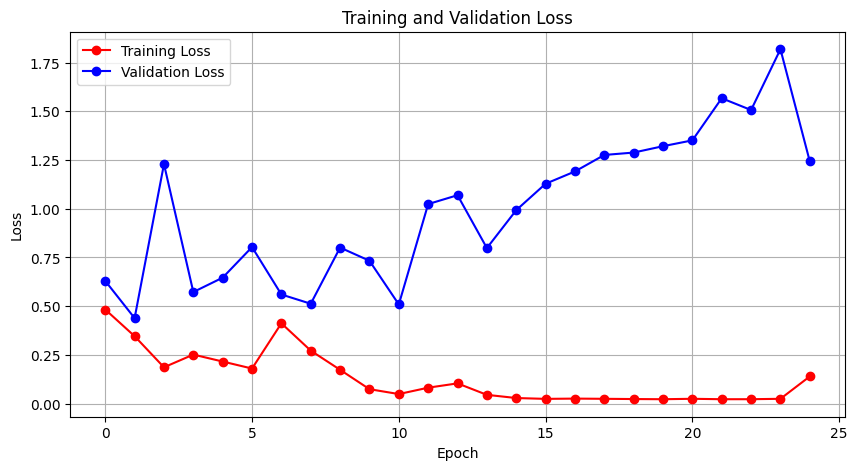

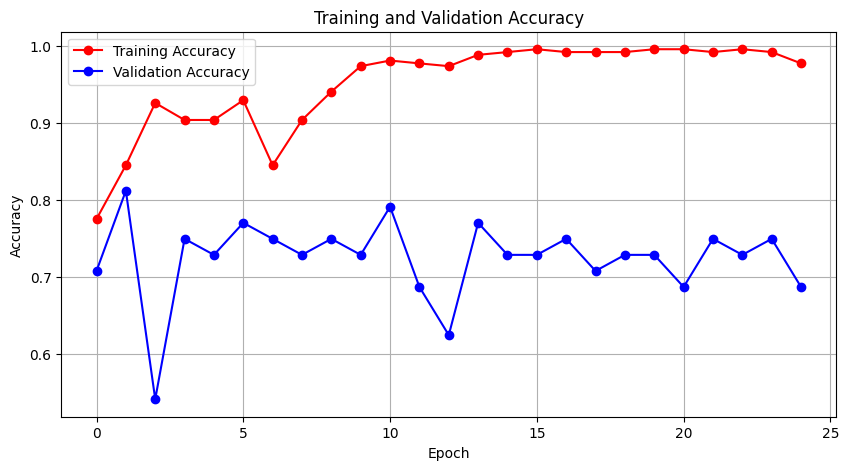

In [50]:
import matplotlib.pyplot as plt

# Define the training history
history = {
    "loss": [0.4830, 0.3462, 0.1866, 0.2518, 0.2161, 0.1802, 0.4123, 0.2721, 0.1737, 0.0743,
             0.0493, 0.0820, 0.1041, 0.0453, 0.0289, 0.0246, 0.0260, 0.0249, 0.0237, 0.0228,
             0.0250, 0.0228, 0.0229, 0.0249, 0.1398],
    "accuracy": [0.7757, 0.8456, 0.9265, 0.9044, 0.9044, 0.9301, 0.8456, 0.9044, 0.9412, 0.9743,
                 0.9816, 0.9779, 0.9743, 0.9890, 0.9926, 0.9963, 0.9926, 0.9926, 0.9926, 0.9963,
                 0.9963, 0.9926, 0.9963, 0.9926, 0.9779],
    "val_loss": [0.6297, 0.4388, 1.2291, 0.5727, 0.6465, 0.8034, 0.5601, 0.5127, 0.8009, 0.7332,
                 0.5091, 1.0240, 1.0695, 0.7984, 0.9928, 1.1283, 1.1914, 1.2760, 1.2883, 1.3210,
                 1.3509, 1.5670, 1.5065, 1.8185, 1.2428],
    "val_accuracy": [0.7083, 0.8125, 0.5417, 0.7500, 0.7292, 0.7708, 0.7500, 0.7292, 0.7500, 0.7292,
                     0.7917, 0.6875, 0.6250, 0.7708, 0.7292, 0.7292, 0.7500, 0.7083, 0.7292, 0.7292,
                     0.6875, 0.7500, 0.7292, 0.7500, 0.6875]
}

# Plot training and validation loss
plt.figure(figsize=(10, 5))
plt.plot(history['loss'], label='Training Loss', color='red', marker='o')
plt.plot(history['val_loss'], label='Validation Loss', color='blue', marker='o')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()

# Plot training and validation accuracy
plt.figure(figsize=(10, 5))
plt.plot(history['accuracy'], label='Training Accuracy', color='red', marker='o')
plt.plot(history['val_accuracy'], label='Validation Accuracy', color='blue', marker='o')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()


#Prediction

In [23]:
# Make predictions on the test set
predictions = model.predict(X_test_resized)

# Convert predictions to class labels
predicted_labels = (predictions > 0.5).astype(int)

# Evaluate the predictions
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

accuracy = accuracy_score(yb_test, predicted_labels)
precision = precision_score(yb_test, predicted_labels)
recall = recall_score(yb_test, predicted_labels)
f1 = f1_score(yb_test, predicted_labels)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)


2/2 [==============================] - 17s 3s/step
Accuracy: 0.55
Precision: 0.5526315789473685
Recall: 0.9545454545454546
F1 Score: 0.7000000000000001


In [24]:
# Make predictions on the test set
predictions = model.predict(X1_test_resized)

# Convert predictions to class labels
predicted_labels = (predictions > 0.5).astype(int)

# Evaluate the predictions
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

accuracy = accuracy_score(yb1_test, predicted_labels)
precision = precision_score(yb1_test, predicted_labels)
recall = recall_score(yb1_test, predicted_labels)
f1 = f1_score(yb1_test, predicted_labels)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

2/2 [==============================] - 10s 2s/step
Accuracy: 0.55
Precision: 0.55
Recall: 1.0
F1 Score: 0.7096774193548387


In [51]:
# Make predictions on the test set
predictions = model.predict(X3_test_resized)

# Convert predictions to class labels
predicted_labels = (predictions > 0.5).astype(int)

# Evaluate the predictions
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

accuracy = accuracy_score(yb3_test, predicted_labels)
precision = precision_score(yb3_test, predicted_labels)
recall = recall_score(yb3_test, predicted_labels)
f1 = f1_score(yb3_test, predicted_labels)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)


3/3 [==============================] - 23s 5s/step
Accuracy: 0.65
Precision: 0.5483870967741935
Recall: 1.0
F1 Score: 0.7083333333333333


In [65]:
import os
import numpy as np
import nibabel as nib
from skimage.transform import resize
from PIL import Image

# Load and preprocess the new image
new_image_path = '/content/drive/MyDrive/SMCI_R/ADNI_009_S_1030_MR_MPR__GradWarp__N3__Scaled_Br_20071127112217373_S42811_I83352_mask_R.nii.gz_brain_mask_R.nii.gz_brain_mask_R.nii.gz'
new_image = nib.load(new_image_path).get_fdata()
new_image_resized = resize(new_image, (72, 64, 64))  # Resize the image to match the input size
new_image_normalized = new_image_resized / np.max(new_image_resized)  # Normalize the image

# Reshape the image to match the input shape expected by the model
input_image = new_image_normalized.reshape(1, 72, 64, 64, 1)
# Define class labels and their corresponding categories
class_labels = {0: 'PMCI', 1: 'SMCI'}

# Predict the class of the image
class_probabilities = model.predict(input_image)

# Assuming binary classification, determine the predicted class label
predicted_class = 1 if class_probabilities[0] > 0.5 else 0

# If you have class names, you can map the predicted label accordingly
class_names = ['Class 0', 'Class 1']  # Example class names
predicted_class_name = class_names[predicted_class]

print("Predicted Class:", predicted_class_name)


1/1 [==============================] - 0s 218ms/step
Predicted Class: Class 1
